# Noise Model

In [144]:
using wgregseq, CairoMakie, CSV, DataFrames, Statistics, Distributions, Clustering, Random, KernelDensity, StatsBase

wgregseq.viz.default_makie!()

## Import mapping data

In [2]:
df_map = CSV.read(
    "../../../data/barcode_maps/20220514_mapping/mapped_barcodes_filtered.csv", 
    DataFrame, 
);

In [3]:
# Filter out unnannotad sequences
df_map = df_map[df_map.name .!= "*", :]

# Filter out non-unique barcodes
gdf = groupby(df_map[(df_map.counts .> 2), :], :barcode)
_df = DataFrame()
for df in gdf
    if nrow(df) == 1
        append!(_df, df)
    end
end
df_map = copy(_df);

In [4]:
# Get twist order to get wild type sequences
df_seqs = wgregseq.utils.import_twist_order("../../../data/twist_orders/2022-02-15_twist_order.csv")
df_wt = df_seqs[1:1501:119*1501, :];
insertcols!(df_wt, 4, :promoter_seq => [string(x[27:186]) for x in df_wt.sequence])

df_wt.promoter_seq |> unique |> length
df_map = leftjoin(df_map, rename(df_wt[!, [:promoter, :promoter_seq]], :promoter => :name), on="name")
rename!(df_map, :promoter_seq => :wt_seq);

In [5]:
function get_dataset(i, promoter="all")
    if  isfile("../../../data/barcode_counts/20240621_barcode/$(i)_DNA_collapsed.txt")
        df_DNA = CSV.read(
            "../../../data/barcode_counts/20240621_barcode/$(i)_DNA_collapsed.txt", 
            DataFrame, 
            ignorerepeated=true, 
            delim=" ", 
            header=["ct_0", "barcode"]
        )
        # import RNA
        df_RNA = CSV.read(
            "../../../data/barcode_counts/20240621_barcode/$(i)_RNA_collapsed.txt", 
            DataFrame, 
            ignorerepeated=true, 
            delim=" ", 
            header=["ct_1", "barcode"]
        )
    elseif isfile("../../../data/barcode_counts/20231207_barcode/$(i)_DNA_collapsed.txt")
        df_DNA = CSV.read(
            "../../../data/barcode_counts/20231207_barcode/$(i)_DNA_collapsed.txt", 
            DataFrame, 
            ignorerepeated=true, 
            delim=" ", 
            header=["ct_0", "barcode"]
        )
        # import RNA
        df_RNA = CSV.read(
            "../../../data/barcode_counts/20231207_barcode/$(i)_RNA_collapsed.txt", 
            DataFrame, 
            ignorerepeated=true, 
            delim=" ", 
            header=["ct_1", "barcode"])
    elseif isfile("../../../data/barcode_counts/20230907_barcode/$(i)_DNA_collapsed.txt")
        df_DNA = CSV.read(
            "../../../data/barcode_counts/20230907_barcode/$(i)_DNA_collapsed.txt", 
            DataFrame, 
            ignorerepeated=true, 
            delim=" ", 
            header=["ct_0", "barcode"]
        )
        # import RNA
        df_RNA = CSV.read(
            "../../../data/barcode_counts/20230907_barcode/$(i)_RNA_collapsed.txt", 
            DataFrame, 
            ignorerepeated=true, 
            delim=" ", 
            header=["ct_1", "barcode"])
        
    elseif isfile("../../../data/barcode_counts/20240514_barcode_test/$(i)_DNA_collapsed.txt")
        df_DNA = CSV.read(
            "../../../data/barcode_counts/20240514_barcode_test/$(i)_DNA_collapsed.txt", 
            DataFrame, 
            ignorerepeated=true, 
            delim=" ", 
            header=["ct_0", "barcode"]
        )
        # import RNA
        df_RNA = CSV.read(
            "../../../data/barcode_counts/20240514_barcode_test/$(i)_RNA_collapsed.txt", 
            DataFrame, 
            ignorerepeated=true, 
            delim=" ", 
            header=["ct_1", "barcode"])
    end
    
    # merge DNA and RNA reads
    df = outerjoin(df_DNA, df_RNA, on=:barcode)
    
    # replace missing reads with 0
    replace!(df.ct_0, missing => 0)
    replace!(df.ct_1, missing => 0)
    
    # identify promoter sequences
    df = innerjoin(df, df_map, on=:barcode)
    
    # compute total counts
    insertcols!(df, 1, :ct => df.ct_0 .+ df.ct_1)
    insertcols!(df, 1, :relative_counts => (df.ct_1 .+ 1) ./ (df.ct_0 .+ 1))
    
    # Turn sequences into integer
    insertcols!(df, 3, :int_promoter => wgregseq.footprints.make_int.(df[:, :promoter]))
    insertcols!(df, 3, :int_wt => wgregseq.footprints.make_int.(df[:, :wt_seq]));
    if promoter != "all"
        df = df[df.name .== promoter, :]
    end
    return df
end

function get_reps(gc, promoter="all")
    gcs = unique([x[1] for x in split.(vcat(readdir("../../../data/barcode_counts/20240514_barcode_test/"), 
                                        readdir("../../../data/barcode_counts/20230907_barcode/"), 
                                        readdir("../../../data/barcode_counts/20231207_barcode/"), 
                                        readdir("../../../data/barcode_counts/20240621_barcode/")), "_")])
    gcs = gcs[map(x -> x == gc, [split(y, '-')[1] for y in gcs])]
    df = DataFrame()
    reps = [split(x, '-')[2] for x in gcs]
    for (gc, rep) in zip(gcs, reps)
        _df = get_dataset(gc, promoter)
        insertcols!(_df, 4, :replicate => rep)
        append!(df, _df)
    end
    return df
end

    
    

get_reps (generic function with 2 methods)

In [269]:
gcs = unique([x[1] for x in split.(vcat(readdir("../../../data/barcode_counts/20240514_barcode_test/"), 
                                        readdir("../../../data/barcode_counts/20230907_barcode/"), 
                                        readdir("../../../data/barcode_counts/20231207_barcode/"), 
                                        readdir("../../../data/barcode_counts/20240621_barcode/")), "_")])
gcs = unique([split(y, '-')[1] for y in gcs])
gcs = filter(x -> x != ".DS", gcs)

39-element Vector{SubString{String}}:
 "11"
 "21"
 "4"
 "1"
 "10"
 "12"
 "13"
 "2"
 "3"
 "5"
 "6"
 "7"
 "14"
 ⋮
 "32"
 "33"
 "35"
 "36"
 "37"
 "9"
 "31"
 "34"
 "38"
 "39"
 "40"
 "8"

In [277]:
df_gcs = CSV.read("growth_conditions.csv", DataFrame)
gc_names = Dict(gcs .=> [replace(df_gcs[parse(Int64, x), :Condition]," " => "_") for x in gcs])
keys(gc_names) |> collect

39-element Vector{SubString{String}}:
 "24"
 "4"
 "1"
 "12"
 "29"
 "20"
 "32"
 "2"
 "6"
 "25"
 "23"
 "22"
 "11"
 ⋮
 "34"
 "8"
 "36"
 "26"
 "17"
 "10"
 "19"
 "37"
 "18"
 "9"
 "30"
 "3"

In [6]:
function shuffle_counts!(df)
    inds = randperm(nrow(df))
    df.ct_0 = df.ct_0[inds]
    df.ct_1 = df.ct_1[inds]
    df.relative_counts = df.relative_counts[inds]
    df.ct = df.ct[inds]
    return df
end

shuffle_counts! (generic function with 1 method)

In [122]:
function shuffle_reps(gc, promoter; d=1, shuffles=1)
    footprints = []
    # get dataset
    df = get_reps(gc, promoter)

    # get footprints for data
    for gdf in groupby(df, :replicate)  
        if d == 0
            push!(footprints, wgregseq.footprints.mutual_information_mutation(gdf, vec=true))
        else
            x = wgregseq.footprints.mutual_information_mutation(gdf, vec=true)
            push!(footprints, [mean(x[i-d:i+d]) for i in 1+d:160-d])
        end
    end
    # rep1
    data_rep1 = footprints[1] ./ sum(footprints[1])
    #rep2
    data_rep2 = footprints[2] ./ sum(footprints[2])
    # sum of replicates (each replicate normalized)
    data_1d = (footprints[1] ./ sum(footprints[1])) .+ (footprints[2] ./ sum(footprints[2]))
    # difference in replicates over sum of replicates (each replicate normalized)
    data_1d_2 = ((footprints[1] ./ sum(footprints[1])) .- (footprints[2] ./ sum(footprints[2]))) ./ ((footprints[1] ./ sum(footprints[1])) .+ (footprints[2] ./ sum(footprints[2])))
    # 
    data_2d = [[footprints[1][i] / sum(footprints[1]), footprints[2][i] / sum(footprints[2])] for i in 1:length(footprints[1])]


    
    shuffle_1d = []
    shuffle_1d_2 = []
    shuffle_2d = []
    shuffle_rep1 = []
    shuffle_rep2 = []

    # Shuffle data and recompute footprints
    for i in 1:shuffles
        for gdf in groupby(shuffle_counts!(df), :replicate)  
            if d == 0
                push!(footprints, wgregseq.footprints.mutual_information_mutation(gdf, vec=true))
            else
                x = wgregseq.footprints.mutual_information_mutation(gdf, vec=true)
                push!(footprints, [mean(x[i-d:i+d]) for i in 1+d:160-d])
            end
        end
        # rep 1
        push!(shuffle_rep1, footprints[2i+1]...)
        # rep 2
        push!(shuffle_rep2, footprints[2i+2]...)
        # sum of normalized reps
        push!(shuffle_1d, ((footprints[2i+1] ./ sum(footprints[2i+1])) .+ (footprints[2i+2] ./ sum(footprints[2i+2])))...)
        # difference of reps divided by their sum
        push!(shuffle_1d_2, (((footprints[2i+1] ./ sum(footprints[2i+1])) .- (footprints[2i+2] ./ sum(footprints[2i+2]))) ./ ((footprints[2i+1] ./ sum(footprints[2i+1])) .+ (footprints[2i+2] ./ sum(footprints[2i+2]))))...)
        push!(shuffle_2d, (footprints[2i+1] ./ sum(footprints[2i+1]), (footprints[2i+2] ./ sum(footprints[2i+2]))))
    end

    
    println(size(mean(Matrix(shuffle_rep1), dims=2)))
    return 

    shuffle_rep1_mean ./= shuffles
    shuffle_rep2_mean ./= shuffles

    sub_rep1 = map(x -> max(x, 0), footprints[1] .- shuffle_rep1_mean)
    sub_rep2 = map(x -> max(x, 0), footprints[2] .- shuffle_rep2_mean)

    # init figure and grid
    fig = Figure(size=(2000, 1000))

    ga = fig[1:4, 1:2] = GridLayout()
    gb = fig[1:4, 3] = GridLayout()
    gc = fig[1:4, 4] = GridLayout()
    
    gd = fig[5, 1:3] = GridLayout()
    ge = fig[1:4, 5] = GridLayout()
    
    gca = gc[1, 1] = GridLayout()
    gcb = gc[2, 1] = GridLayout()

    gea = ge[1, 1] = GridLayout()
    geb = ge[2, 1] = GridLayout()

    # Plot footprints for data and shuffles
    ax1 = Axis(ga[1, 1], title="Original 1", xlabel="position", ylabel="mutual\n information", xticks=-110:5:40, xticklabelsize=7)
    ax2 = Axis(ga[2, 1], title="Original 2", xlabel="position", ylabel="mutual\n information", xticks=-110:5:40, xticklabelsize=7)
    ax3 = Axis(ga[3, 1], title="Background subtracted Rep 1", xlabel="position", ylabel="mutual\n information", xticks=-110:5:40, xticklabelsize=7)
    ax4 = Axis(ga[4, 1], title="Background subtracted Rep 2", xlabel="position", ylabel="mutual\n information", xticks=-110:5:40, xticklabelsize=7)
    
    barplot!(ax1, -115+d:44-d, footprints[1], color="orange")
    barplot!(ax2, -115+d:44-d, footprints[2], color="orange")
    lines!(ax1, -115+d:44-d, shuffle_rep1_mean, color="black")
    lines!(ax2, -115+d:44-d, shuffle_rep2_mean, color="black")
    barplot!(ax3, -115+d:44-d, sub_rep1, color="gray")
    barplot!(ax4, -115+d:44-d, sub_rep2, color="gray")

    println(mean(shuffle_rep1_mean))
    println(mean(shuffle_rep2_mean))
    
    # plot scatter of rep1 vs rep2 and sum of reps vs differenc of reps
    ax11 = Axis(gb[1, 1], xlabel="replicate 1", ylabel="replicate 2", title="Normalized mutual\n information")
    ax22 = Axis(gb[2, 1], xlabel="rep 1 + rep 2", ylabel="(rep 1 - rep 2)/(rep 1 + rep 2)")
    
    # only plot subset of scatters to not overfill plot
    for i in 1:min(shuffles, 10)
        scatter!(ax11, footprints[2i + 1] ./ sum(footprints[2i + 1]), footprints[2i + 2] ./ sum(footprints[2i + 2]), color="gray", label="Shuffle")
        scatter!(ax22, footprints[2i + 1] ./ sum(footprints[2i + 1]) .+ footprints[2i + 2] ./ sum(footprints[2i + 2]), (footprints[2i + 1] ./ sum(footprints[2i + 1]) .- footprints[2i + 2] ./ sum(footprints[2i + 2])) ./ (footprints[2i + 1] ./ sum(footprints[2i + 1]) .+ footprints[2i + 2] ./ sum(footprints[2i + 2])), color="gray", label="Shuffle")
    end
    
    # plot data on top of scatter
    scatter!(ax11, footprints[1] ./ sum(footprints[1]), footprints[2] ./ sum(footprints[2]), color="orange", label="Original")
    scatter!(ax22, footprints[1] ./ sum(footprints[1]) .+ footprints[2] ./ sum(footprints[2]), (footprints[1] ./ sum(footprints[1]) .- footprints[2] ./ sum(footprints[2])) ./ (footprints[1] ./ sum(footprints[1]) .+ footprints[2] ./ sum(footprints[2])), label="Original", color="orange")
    
    # compute ecdf of data
    ecdf = sort(data_1d)
    ecdf_2 = sort(data_1d_2)
    
    # compute ecdf of shuffles (estimate for cdf)
    cdf = [ sum(x .>= shuffle_1d) for x in ecdf] ./ length(shuffle_1d)
    cdf_2 = [ sum(x .>= shuffle_1d_2) for x in ecdf_2] ./ length(shuffle_1d_2)
    
    # compute Kolmogorov-Smirnov test and plot ecdf
    KST = maximum(abs.(collect(1/length(ecdf):1/length(ecdf):1) .- cdf))
    ax = Axis(gca[1, 1], xlabel="rep1 + rep2", ylabel="ECDF")
    lines!(ax, ecdf, 1/length(ecdf):1/length(ecdf):1, label="Data", color="orange")
    lines!(ax, ecdf, cdf, label="Shuffles", color="gray")
    ax.title = "Kolmogorov-Smirnov test: $(round(KST, digits=4))"
    axislegend(ax, position=:rb)
    
    # compute Kolmogorov-Smirnov test and plot ecdf
    KST = maximum(abs.(collect(1/length(ecdf_2):1/length(ecdf_2):1) .- cdf_2))
    ax = Axis(gcb[1, 1], xlabel="(rep1 - rep2) / (rep1 + rep2)", title="Kolmogorov-Smirnov test\n (based on rep1 + rep2)", ylabel="ECDF")
    lines!(ax, ecdf_2, 1/length(ecdf_2):1/length(ecdf_2):1, label="Data", color="orange")
    lines!(ax, ecdf_2, cdf_2, label="Shuffles", color="gray")
    ax.title = "Kolmogorov-Smirnov test: $(round(KST, digits=4))"
    axislegend(ax, position=:rb)
    
    
    # compute pdfs
    D = fit(MvNormal, vcat([hcat(shuffle_2d[i]...) for i in 1:length(shuffle_2d)]...)')
    X = vcat([hcat(shuffle_2d[i]...) for i in 1:length(shuffle_2d)]...)'
    B = kde((X[1, :], X[2, :]))
    df_pdf = DataFrame(pdf_MV=pdf(D, hcat(data_2d...)), pdf_KDE=[pdf(B, x...) for x in data_2d], position=collect(-115+d:44-d))
    
    df_pdf.pdf_MV = [max(0, x) for x in df_pdf.pdf_MV] 
    df_pdf.pdf_MV .+= minimum(filter(x -> x > 0, df_pdf.pdf_MV))
    
    df_pdf.pdf_KDE = [max(0, x) for x in df_pdf.pdf_KDE]
    df_pdf.pdf_KDE .+= minimum(filter(x -> x > 0, df_pdf.pdf_KDE))
    
    ax = Axis(gd[1, 1], xlabel="position", ylabel="PDF", xticks=-110:5:40, xticklabelsize=7, yscale=log10)
    scatter!(ax, df_pdf.position, df_pdf.pdf_MV, label="MV-Gaussian")
    scatter!(ax, df_pdf.position, df_pdf.pdf_KDE, label="2D KDE")
    axislegend(ax)
    
    
    # Separate replicates
    ecdf_rep1 = sort(data_rep1)
    cdf_rep1 = [ sum(x .>= shuffle1_flat) for x in ecdf_rep1] ./ length(shuffle1_flat)
    
    ecdf_rep2 = sort(data_rep2)
    cdf_rep2 = [ sum(x .>= shuffle2_flat) for x in ecdf_rep2] ./ length(shuffle2_flat)
    
    ax = Axis(gea[1, 1], xlabel="rep1", ylabel="ECDF")
    lines!(ax, ecdf_rep1, 1/length(ecdf_rep1):1/length(ecdf_rep1):1, label="Data", color="orange")
    lines!(ax, ecdf_rep1, cdf_rep1, label="Shuffles", color="gray")
    
    KST = maximum(abs.(collect(1/length(ecdf_rep1):1/length(ecdf_rep1):1) .- cdf_rep1))
    #ADT = -length(cdf) - sum([(2i - 1) / length(cdf) * (log(cdf[i]) + (1 - log(cdf[end+1-i]))) for i in 1:length(cdf)])
    ax.title = "Kolmogorov-Smirnov test: $(round(KST, digits=4))"
    
    ax = Axis(geb[1, 1], xlabel="rep2", ylabel="ECDF")
    lines!(ax, ecdf_rep2, 1/length(ecdf_rep2):1/length(ecdf_rep2):1, label="Data", color="orange")
    lines!(ax, ecdf_rep2, cdf_rep2, label="Shuffles", color="gray")
    
    KST = maximum(abs.(collect(1/length(ecdf_rep2):1/length(ecdf_rep2):1) .- cdf_rep2))
    ax.title = "Kolmogorov-Smirnov test: $(round(KST, digits=4))"
    
    axislegend(ax, position=:rb)

    return fig
    
end

shuffle_reps (generic function with 1 method)

In [241]:
footprints = []
gc = "3"
promoter = "araBp"
# get dataset


In [238]:
# get footprints for data
for gc in keys(gc_names) |> collect
    gc_name = gc_names[gc]
    df_all = get_reps(gc)
d = 2
shuffles = 1000
for prom in df_all.name |> unique
    df = df_all[df_all.name .== prom, :]
    footprints = []
    for gdf in groupby(df, :replicate)  
        if d == 0
            push!(footprints, wgregseq.footprints.mutual_information_mutation(gdf, vec=true))
        else
            x = wgregseq.footprints.mutual_information_mutation(gdf, vec=true)
            push!(footprints, [mean(x[i-d:i+d]) for i in 1+d:160-d])
        end
    end
    # rep1
    data_rep1 = footprints[1] ./ sum(footprints[1])
    #rep2
    data_rep2 = footprints[2] ./ sum(footprints[2])
    # sum of replicates (each replicate normalized)
    data_1d = (footprints[1] ./ sum(footprints[1])) .+ (footprints[2] ./ sum(footprints[2]))
    # difference in replicates over sum of replicates (each replicate normalized)
    data_1d_2 = ((footprints[1] ./ sum(footprints[1])) .- (footprints[2] ./ sum(footprints[2]))) ./ ((footprints[1] ./ sum(footprints[1])) .+ (footprints[2] ./ sum(footprints[2])))
    # 
    data_2d = [[footprints[1][i] / sum(footprints[1]), footprints[2][i] / sum(footprints[2])] for i in 1:length(footprints[1])]
    
    
    shuffle_1d = []
    shuffle_1d_2 = []
    shuffle_2d = []
    shuffle_rep1 = Vector{Float64}[]
    shuffle_rep2 = []
    
    # Shuffle data and recompute footprints
    for i in 1:shuffles
        for gdf in groupby(shuffle_counts!(df), :replicate)  
            if d == 0
                push!(footprints, wgregseq.footprints.mutual_information_mutation(gdf, vec=true))
            else
                x = wgregseq.footprints.mutual_information_mutation(gdf, vec=true)
                push!(footprints, [mean(x[i-d:i+d]) for i in 1+d:160-d])
            end
        end
        # rep 1
        push!(shuffle_rep1, footprints[2i+1])
        # rep 2
        push!(shuffle_rep2, footprints[2i+2])
        # sum of normalized reps
        push!(shuffle_1d, ((footprints[2i+1] ./ sum(footprints[2i+1])) .+ (footprints[2i+2] ./ sum(footprints[2i+2])))...)
        # difference of reps divided by their sum
        push!(shuffle_1d_2, (((footprints[2i+1] ./ sum(footprints[2i+1])) .- (footprints[2i+2] ./ sum(footprints[2i+2]))) ./ ((footprints[2i+1] ./ sum(footprints[2i+1])) .+ (footprints[2i+2] ./ sum(footprints[2i+2]))))...)
        push!(shuffle_2d, (footprints[2i+1] ./ sum(footprints[2i+1]), (footprints[2i+2] ./ sum(footprints[2i+2]))))
    end
    
    med1 = median(hcat(shuffle_rep1...), dims=2)
    med2 = median(hcat(shuffle_rep2...), dims=2)
    
    shuffle_rep1_mat = hcat(shuffle_rep1...)
    quantiles1 = [quantile(shuffle_rep1_mat[i, :], [0.25, 0.75]) for i in 1:160-2d]
    shuffle_rep2_mat = hcat(shuffle_rep2...)
    quantiles2 = [quantile(shuffle_rep2_mat[i, :], [0.25, 0.75]) for i in 1:160-2d]
    
    shuffle1_flat = vcat((shuffle_rep1 ./ vec(sum(hcat(shuffle_rep1...), dims=1)))...)
    shuffle2_flat = vcat((shuffle_rep2 ./ vec(sum(hcat(shuffle_rep2...), dims=1)))...)
    
    rep1_sub = map(x -> max(x, 0), footprints[1] .- vec(med1))
    rep2_sub = map(x -> max(x, 0), footprints[2] .- vec(med2))
    
    # compute pdfs
    D = fit(MvNormal, vcat([hcat(shuffle_2d[i]...) for i in 1:length(shuffle_2d)]...)')
    X = vcat([hcat(shuffle_2d[i]...) for i in 1:length(shuffle_2d)]...)'
    B = kde((X[1, :], X[2, :]))
    df_pdf = DataFrame(pdf_MV=pdf(D, hcat(data_2d...)), pdf_KDE=[pdf(B, x...) for x in data_2d], position=collect(-115+d:44-d))
    
    df_pdf.pdf_MV = [max(0, x) for x in df_pdf.pdf_MV] 
    df_pdf.pdf_MV .+= minimum(filter(x -> x > 0, df_pdf.pdf_MV))
    
    df_pdf.pdf_KDE = [max(0, x) for x in df_pdf.pdf_KDE]
    df_pdf.pdf_KDE .+= minimum(filter(x -> x > 0, df_pdf.pdf_KDE))
    
    # compute ecdf of data
    ecdf = sort(data_1d)
    ecdf_2 = sort(data_1d_2)
    
    # compute ecdf of shuffles (estimate for cdf)
    cdf = [ sum(x .>= shuffle_1d) for x in ecdf] ./ length(shuffle_1d)
    cdf_2 = [ sum(x .>= shuffle_1d_2) for x in ecdf_2] ./ length(shuffle_1d_2)
    
    # Separate replicates
    ecdf_rep1 = sort(data_rep1)
    cdf_rep1 = [ sum(x .>= shuffle1_flat) for x in ecdf_rep1] ./ length(shuffle1_flat)
    
    ecdf_rep2 = sort(data_rep2)
    cdf_rep2 = [ sum(x .>= shuffle2_flat) for x in ecdf_rep2] ./ length(shuffle2_flat);
    
    pdf_cutoff = 1
    colors = df_pdf.pdf_MV .< pdf_cutoff
#colors = df_pdf.pdf_KDE .< pdf_cutoff

156-element BitVector:
 0
 0
 0
 0
 0
 0
 0
 0
 0
 0
 0
 0
 0
 ⋮
 0
 0
 0
 0
 0
 0
 0
 0
 0
 0
 0
 0

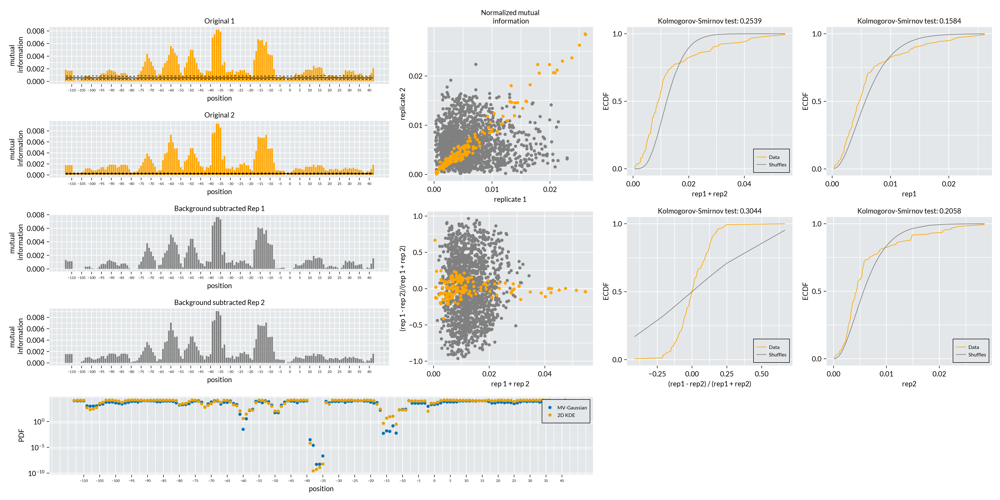

In [239]:
# init figure and grid
fig = Figure(size=(2000, 1000))

ga = fig[1:4, 1:2] = GridLayout()
gb = fig[1:4, 3] = GridLayout()
gc = fig[1:4, 4] = GridLayout()

gd = fig[5, 1:3] = GridLayout()
ge = fig[1:4, 5] = GridLayout()

gca = gc[1, 1] = GridLayout()
gcb = gc[2, 1] = GridLayout()

gea = ge[1, 1] = GridLayout()
geb = ge[2, 1] = GridLayout()

# Plot footprints for data and shuffles
ax1 = Axis(ga[1, 1], title="Original 1", xlabel="position", ylabel="mutual\n information", xticks=-110:5:40, xticklabelsize=7)
ax2 = Axis(ga[2, 1], title="Original 2", xlabel="position", ylabel="mutual\n information", xticks=-110:5:40, xticklabelsize=7)
ax3 = Axis(ga[3, 1], title="Background subtracted Rep 1", xlabel="position", ylabel="mutual\n information", xticks=-110:5:40, xticklabelsize=7)
ax4 = Axis(ga[4, 1], title="Background subtracted Rep 2", xlabel="position", ylabel="mutual\n information", xticks=-110:5:40, xticklabelsize=7)

barplot!(ax1, -115+d:44-d, footprints[1], color="orange")
lines!(ax1, -115+d:44-d, vec(med1), color="black")
lines!(ax1, -115+d:44-d, hcat(quantiles1...)[1, :], color="black", linestyle=:dash)
lines!(ax1, -115+d:44-d, hcat(quantiles1...)[2, :], color="black", linestyle=:dash)

barplot!(ax2, -115+d:44-d, footprints[2], color="orange")
lines!(ax2, -115+d:44-d, vec(med2), color="black")
lines!(ax2, -115+d:44-d, hcat(quantiles2...)[1, :], color="black", linestyle=:dash)
lines!(ax2, -115+d:44-d, hcat(quantiles2...)[2, :], color="black", linestyle=:dash)

barplot!(ax3, -115+d:44-d, rep1_sub, color="gray")
barplot!(ax4, -115+d:44-d, rep2_sub, color="gray")

# plot scatter of rep1 vs rep2 and sum of reps vs differenc of reps
ax11 = Axis(gb[1, 1], xlabel="replicate 1", ylabel="replicate 2", title="Normalized mutual\n information")
ax22 = Axis(gb[2, 1], xlabel="rep 1 + rep 2", ylabel="(rep 1 - rep 2)/(rep 1 + rep 2)")

# only plot subset of scatters to not overfill plot
for i in 1:min(shuffles, 10)
    scatter!(ax11, footprints[2i + 1] ./ sum(footprints[2i + 1]), footprints[2i + 2] ./ sum(footprints[2i + 2]), color="gray", label="Shuffle")
    scatter!(ax22, footprints[2i + 1] ./ sum(footprints[2i + 1]) .+ footprints[2i + 2] ./ sum(footprints[2i + 2]), (footprints[2i + 1] ./ sum(footprints[2i + 1]) .- footprints[2i + 2] ./ sum(footprints[2i + 2])) ./ (footprints[2i + 1] ./ sum(footprints[2i + 1]) .+ footprints[2i + 2] ./ sum(footprints[2i + 2])), color="gray", label="Shuffle")
end

# plot data on top of scatter
scatter!(ax11, footprints[1] ./ sum(footprints[1]), footprints[2] ./ sum(footprints[2]), color="orange", label="Original")
scatter!(ax22, footprints[1] ./ sum(footprints[1]) .+ footprints[2] ./ sum(footprints[2]), (footprints[1] ./ sum(footprints[1]) .- footprints[2] ./ sum(footprints[2])) ./ (footprints[1] ./ sum(footprints[1]) .+ footprints[2] ./ sum(footprints[2])), label="Original", color="orange")


# compute Kolmogorov-Smirnov test and plot ecdf
KST = maximum(abs.(collect(1/length(ecdf):1/length(ecdf):1) .- cdf))
ax = Axis(gca[1, 1], xlabel="rep1 + rep2", ylabel="ECDF")
lines!(ax, ecdf, 1/length(ecdf):1/length(ecdf):1, label="Data", color="orange")
lines!(ax, ecdf, cdf, label="Shuffles", color="gray")
ax.title = "Kolmogorov-Smirnov test: $(round(KST, digits=4))"
axislegend(ax, position=:rb)

# compute Kolmogorov-Smirnov test and plot ecdf
KST = maximum(abs.(collect(1/length(ecdf_2):1/length(ecdf_2):1) .- cdf_2))
ax = Axis(gcb[1, 1], xlabel="(rep1 - rep2) / (rep1 + rep2)", title="Kolmogorov-Smirnov test\n (based on rep1 + rep2)", ylabel="ECDF")
lines!(ax, ecdf_2, 1/length(ecdf_2):1/length(ecdf_2):1, label="Data", color="orange")
lines!(ax, ecdf_2, cdf_2, label="Shuffles", color="gray")
ax.title = "Kolmogorov-Smirnov test: $(round(KST, digits=4))"
axislegend(ax, position=:rb)


ax = Axis(gd[1, 1], xlabel="position", ylabel="PDF", xticks=-110:5:40, xticklabelsize=7, yscale=log10)
scatter!(ax, df_pdf.position, df_pdf.pdf_MV, label="MV-Gaussian")
scatter!(ax, df_pdf.position, df_pdf.pdf_KDE, label="2D KDE")
axislegend(ax)

ax = Axis(gea[1, 1], xlabel="rep1", ylabel="ECDF")
lines!(ax, ecdf_rep1, 1/length(ecdf_rep1):1/length(ecdf_rep1):1, label="Data", color="orange")
lines!(ax, ecdf_rep1, cdf_rep1, label="Shuffles", color="gray")

KST = maximum(abs.(collect(1/length(ecdf_rep1):1/length(ecdf_rep1):1) .- cdf_rep1))
ax.title = "Kolmogorov-Smirnov test: $(round(KST, digits=4))"

ax = Axis(geb[1, 1], xlabel="rep2", ylabel="ECDF")
lines!(ax, ecdf_rep2, 1/length(ecdf_rep2):1/length(ecdf_rep2):1, label="Data", color="orange")
lines!(ax, ecdf_rep2, cdf_rep2, label="Shuffles", color="gray")

KST = maximum(abs.(collect(1/length(ecdf_rep2):1/length(ecdf_rep2):1) .- cdf_rep2))
ax.title = "Kolmogorov-Smirnov test: $(round(KST, digits=4))"

axislegend(ax, position=:rb)
fig

In [262]:
gcs

LoadError: UndefVarError: `gcs` not defined

In [279]:
# get footprints for data

for gc in keys(gc_names) |> collect
    gc_name = gc_names[gc]
    df_all = get_reps(gc)
    d = 1
    shuffles = 1000
    for prom in df_all.name |> unique
        if prom in ["galEp", "ybeDp2"]
            continue
        end
        df = df_all[df_all.name .== prom, :]
        footprints = []
        for gdf in groupby(df, :replicate)  
            if d == 0
                push!(footprints, wgregseq.footprints.mutual_information_mutation(gdf, vec=true))
            else
                x = wgregseq.footprints.mutual_information_mutation(gdf, vec=true)
                push!(footprints, [mean(x[i-d:i+d]) for i in 1+d:160-d])
            end
        end
        # rep1
        data_rep1 = footprints[1] ./ sum(footprints[1])
        #rep2
        data_rep2 = footprints[2] ./ sum(footprints[2])
        # sum of replicates (each replicate normalized)
        data_1d = (footprints[1] ./ sum(footprints[1])) .+ (footprints[2] ./ sum(footprints[2]))
        # difference in replicates over sum of replicates (each replicate normalized)
        data_1d_2 = ((footprints[1] ./ sum(footprints[1])) .- (footprints[2] ./ sum(footprints[2]))) ./ ((footprints[1] ./ sum(footprints[1])) .+ (footprints[2] ./ sum(footprints[2])))
        # 
        data_2d = [[footprints[1][i] / sum(footprints[1]), footprints[2][i] / sum(footprints[2])] for i in 1:length(footprints[1])]
        
        
        shuffle_1d = []
        shuffle_1d_2 = []
        shuffle_2d = []
        shuffle_rep1 = Vector{Float64}[]
        shuffle_rep2 = []
        
        # Shuffle data and recompute footprints
        for i in 1:shuffles
            for gdf in groupby(shuffle_counts!(df), :replicate)  
                if d == 0
                    push!(footprints, wgregseq.footprints.mutual_information_mutation(gdf, vec=true))
                else
                    x = wgregseq.footprints.mutual_information_mutation(gdf, vec=true)
                    push!(footprints, [mean(x[i-d:i+d]) for i in 1+d:160-d])
                end
            end
            # rep 1
            push!(shuffle_rep1, footprints[2i+1])
            # rep 2
            push!(shuffle_rep2, footprints[2i+2])
            # sum of normalized reps
            push!(shuffle_1d, ((footprints[2i+1] ./ sum(footprints[2i+1])) .+ (footprints[2i+2] ./ sum(footprints[2i+2])))...)
            # difference of reps divided by their sum
            push!(shuffle_1d_2, (((footprints[2i+1] ./ sum(footprints[2i+1])) .- (footprints[2i+2] ./ sum(footprints[2i+2]))) ./ ((footprints[2i+1] ./ sum(footprints[2i+1])) .+ (footprints[2i+2] ./ sum(footprints[2i+2]))))...)
            push!(shuffle_2d, (footprints[2i+1] ./ sum(footprints[2i+1]), (footprints[2i+2] ./ sum(footprints[2i+2]))))
        end
        
        med1 = median(hcat(shuffle_rep1...), dims=2)
        med2 = median(hcat(shuffle_rep2...), dims=2)
        
        shuffle_rep1_mat = hcat(shuffle_rep1...)
        quantiles1 = [quantile(shuffle_rep1_mat[i, :], [0.25, 0.75]) for i in 1:160-2d]
        shuffle_rep2_mat = hcat(shuffle_rep2...)
        quantiles2 = [quantile(shuffle_rep2_mat[i, :], [0.25, 0.75]) for i in 1:160-2d]
        
        shuffle1_flat = vcat((shuffle_rep1 ./ vec(sum(hcat(shuffle_rep1...), dims=1)))...)
        shuffle2_flat = vcat((shuffle_rep2 ./ vec(sum(hcat(shuffle_rep2...), dims=1)))...)
        
        rep1_sub = map(x -> max(x, 0), footprints[1] .- vec(med1))
        rep2_sub = map(x -> max(x, 0), footprints[2] .- vec(med2))
        
        # compute pdfs
        X = vcat([hcat(shuffle_2d[i]...) for i in 1:length(shuffle_2d)]...)'
        B = kde((X[1, :], X[2, :]))
        df_pdf = DataFrame(pdf_KDE=[pdf(B, x...) for x in data_2d], position=collect(-115+d:44-d))
        
        df_pdf.pdf_KDE = [max(0, x) for x in df_pdf.pdf_KDE]
        df_pdf.pdf_KDE .+= minimum(filter(x -> x > 0, df_pdf.pdf_KDE))
        
        
        pdf_cutoff = 1
        colors = df_pdf.pdf_KDE .< pdf_cutoff
        # init figure and grid
        fig = Figure(size=(1200, 1000))
    
        g = fig[1, 1] = GridLayout()
        ga = g[1, 1] = GridLayout()
        gb = g[2, 1] = GridLayout()
        gc = g[3, 1] = GridLayout()
        gd = g[4, 1] = GridLayout()
        ge = g[5, 1] = GridLayout()
        
        # Plot footprints for data and shuffles
        ax1 = Axis(ga[1, 1], title="$prom arabinoseOriginal 1", xlabel="position", ylabel="mutual\n information", xticks=-110:5:40, xticklabelsize=7)
        ax2 = Axis(gb[1, 1], title="Original 2", xlabel="position", ylabel="mutual\n information", xticks=-110:5:40, xticklabelsize=7)
        ax3 = Axis(gc[1, 1], title="Background subtracted Rep 1", xlabel="position", ylabel="mutual\n information", xticks=-110:5:40, xticklabelsize=7)
        ax4 = Axis(gd[1, 1], title="Background subtracted Rep 2", xlabel="position", ylabel="mutual\n information", xticks=-110:5:40, xticklabelsize=7)
        
        barplot!(ax1, -115+d:44-d, footprints[1], color="orange")
        lines!(ax1, -115+d:44-d, vec(med1), color="black")
        lines!(ax1, -115+d:44-d, hcat(quantiles1...)[1, :], color="black", linestyle=:dash)
        lines!(ax1, -115+d:44-d, hcat(quantiles1...)[2, :], color="black", linestyle=:dash)
        
        barplot!(ax2, -115+d:44-d, footprints[2], color="orange")
        lines!(ax2, -115+d:44-d, vec(med2), color="black")
        lines!(ax2, -115+d:44-d, hcat(quantiles2...)[1, :], color="black", linestyle=:dash)
        lines!(ax2, -115+d:44-d, hcat(quantiles2...)[2, :], color="black", linestyle=:dash)
        
        barplot!(ax3, -115+d:44-d, rep1_sub, color="gray")
        barplot!(ax4, -115+d:44-d, rep2_sub, color="gray")
        
        ax = Axis(ge[1, 1], xlabel="position", ylabel="PDF", xticks=-110:5:40, xticklabelsize=7, yscale=log10)
        scatter!(ax, df_pdf.position, df_pdf.pdf_KDE)
        if ~ispath("./replicate_test/$prom")
            mkdir("./replicate_test/$prom")
        end
        save("./replicate_test/$prom/$prom-$gc_name.pdf", fig)
    end
end

LoadError: InterruptException:

In [258]:
ispath("./replicate_test/")

true

In [261]:
"ybeDp2" in df_all.name |> unique

true

In [123]:
fig = shuffle_reps("36", "yjbJ_predicted"; d=2, shuffles=10)
#save("yjbJ_high-osmo.pdf", fig)
#fig

(1560,)


0.0005052106608131782
0.00014967236002181363


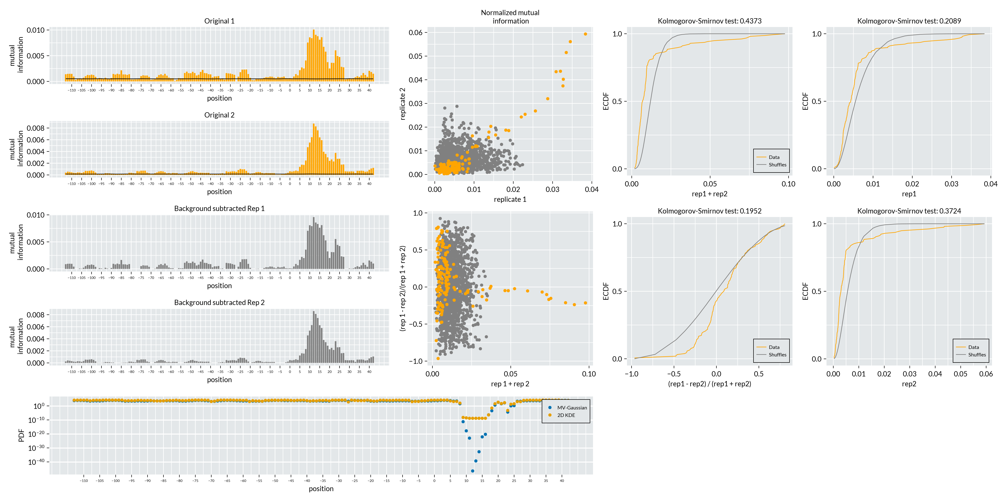

In [104]:
fig = shuffle_reps("7", "yjbJ_predicted"; d=2, shuffles=1000)
save("yjbJ_stat-phase.pdf", fig)
fig

0.000585397714730864
0.00022275925197429402


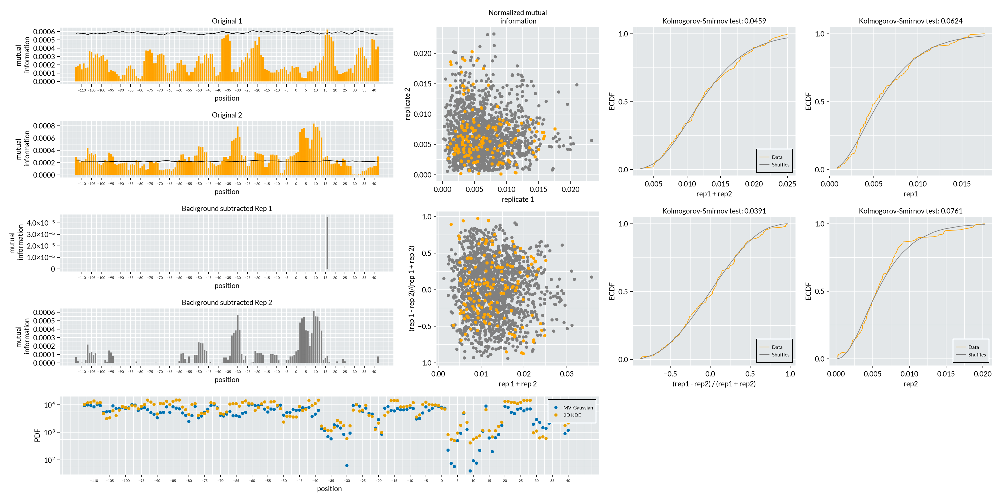

In [105]:
fig = shuffle_reps("3", "yjbJ_predicted"; d=2, shuffles=1000)
save("yjbJ_arabinose.pdf", fig)
fig

0.00020334774055093374
0.0001055755814727919


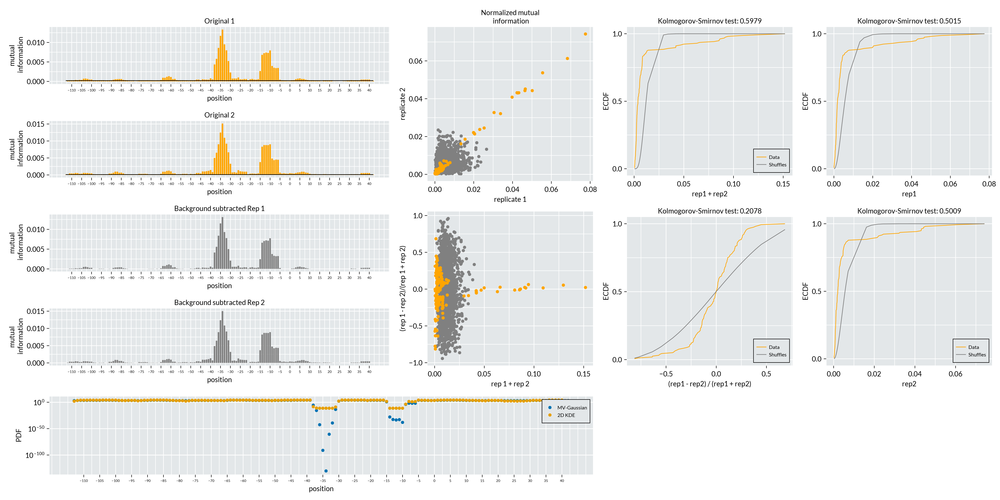

In [106]:
fig = shuffle_reps("3", "dicCp"; d=2, shuffles=1000)
save("dicC_arabinose.pdf", fig)
fig

0.0006382862669424713
0.00025926573212143596


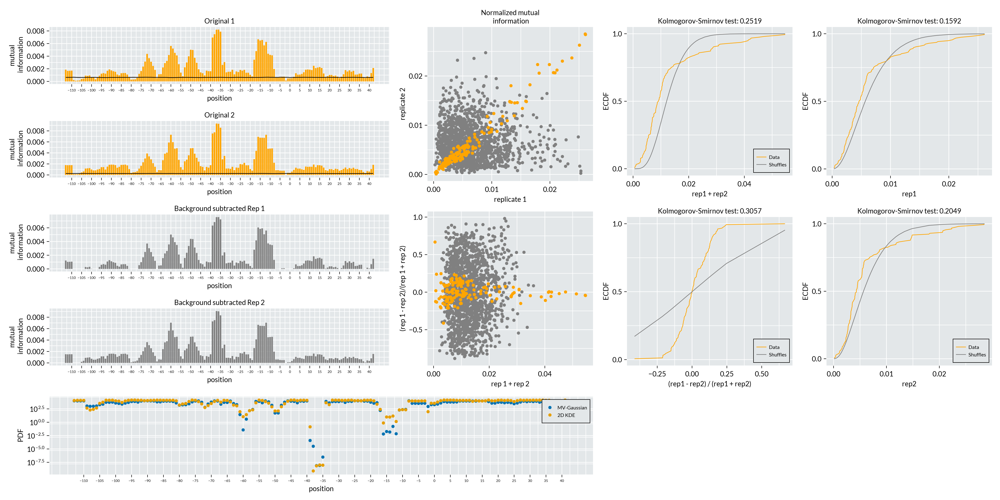

In [107]:
fig = shuffle_reps("3", "araBp"; d=2, shuffles=1000)
save("araB_arabinose.pdf", fig)
fig

5.8695683841165165e-5
5.7882563493031715e-5


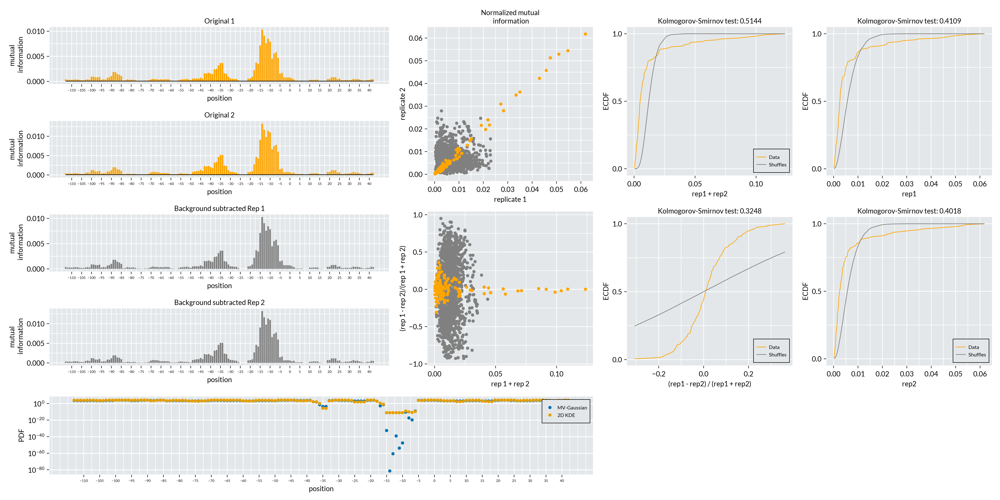

In [108]:
fig = shuffle_reps("37", "ompFp"; d=2, shuffles=1000)
save("ompF_low-osmo.pdf", fig)
fig

8.650731067622398e-5
8.622369987683711e-5


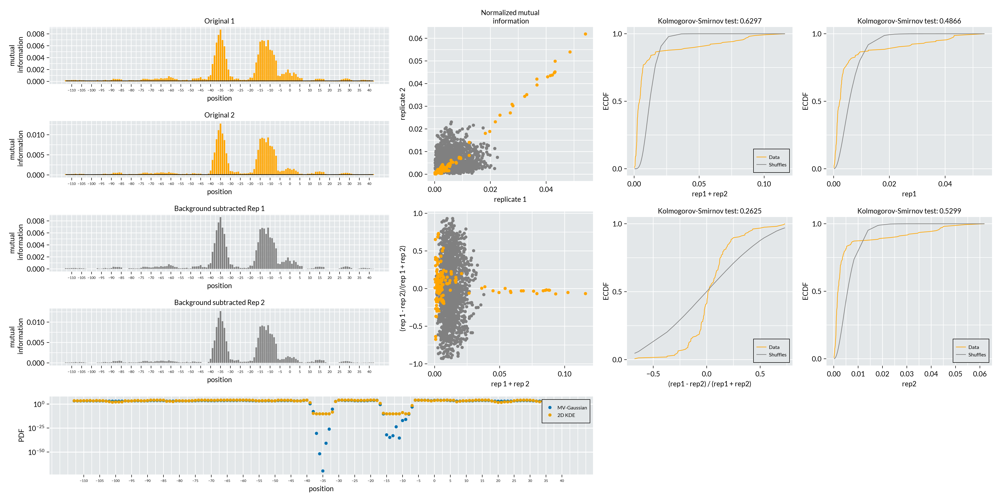

In [109]:
fig = shuffle_reps("37", "marRp"; d=2, shuffles=1000)
save("marR_low-osmo.pdf", fig)
fig

0.0003041365039404584
0.00015618745390141473


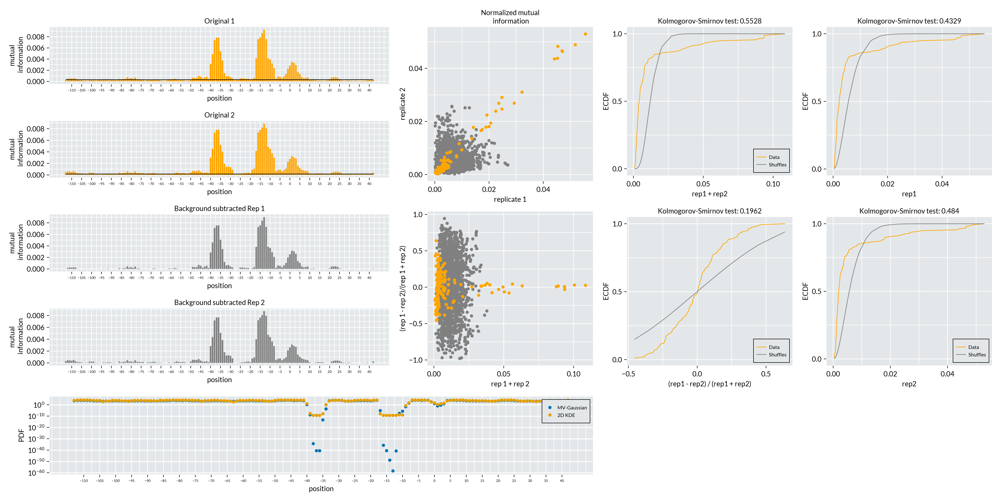

In [110]:
fig = shuffle_reps("3", "sulAp"; d=2, shuffles=1000)
save("sulA_arabinose.pdf", fig)
fig

0.0007347296372431121
0.00029197678623094726


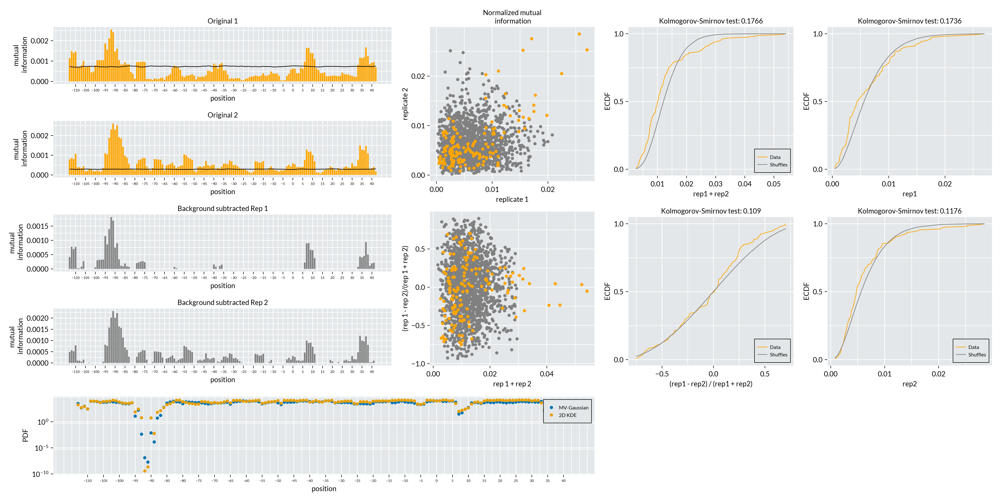

In [111]:
fig = shuffle_reps("3", "dgoRp"; d=2, shuffles=1000)
save("dgoR_arabinose.pdf", fig)
fig

0.0006863248614528129
0.00029586994968131854


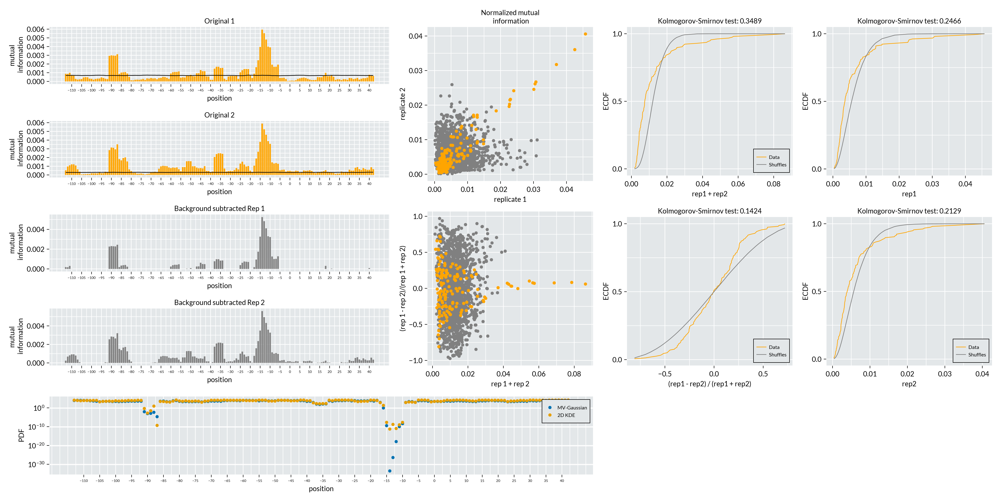

In [112]:
fig = shuffle_reps("3", "znuCp"; d=2, shuffles=1000)
save("znuC_arabinose.pdf", fig)
fig

0.0006403076175317677
0.0002427170592255731


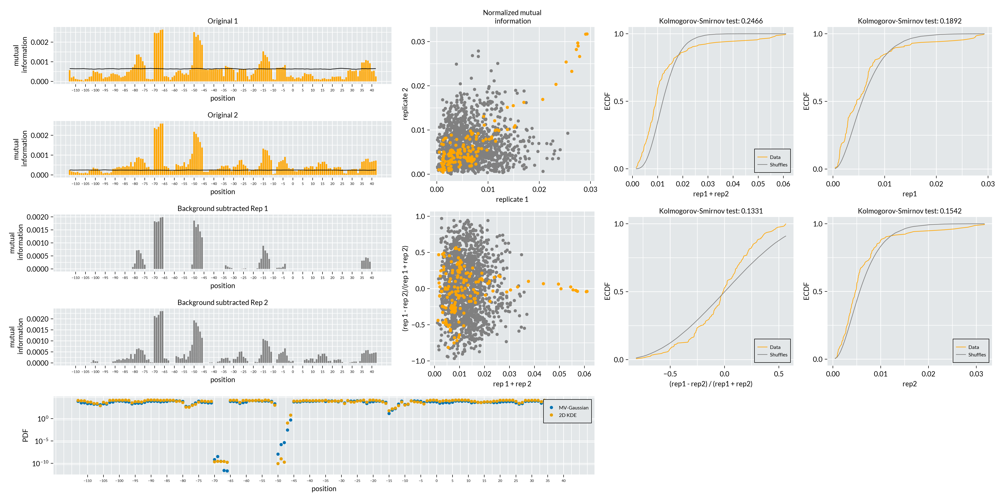

In [113]:
fig = shuffle_reps("3", "xylAp"; d=2, shuffles=1000)
save("xylA_xylose.pdf", fig)
fig

0.0009815358175892688
0.00043564062831315546


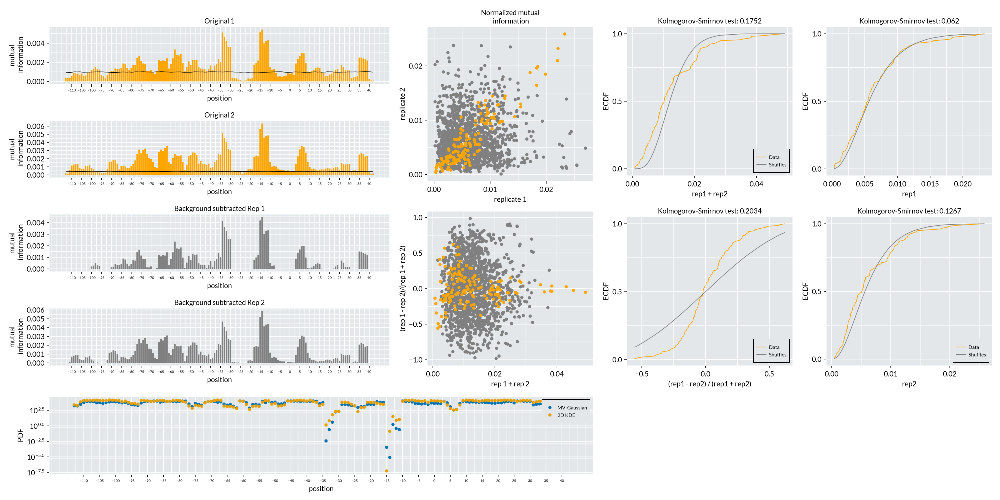

In [114]:
fig = shuffle_reps("2", "xylAp"; d=2, shuffles=1000)
save("xylA_xylose.pdf", fig)
fig

0.0016112530469056892
0.0005875259611088602


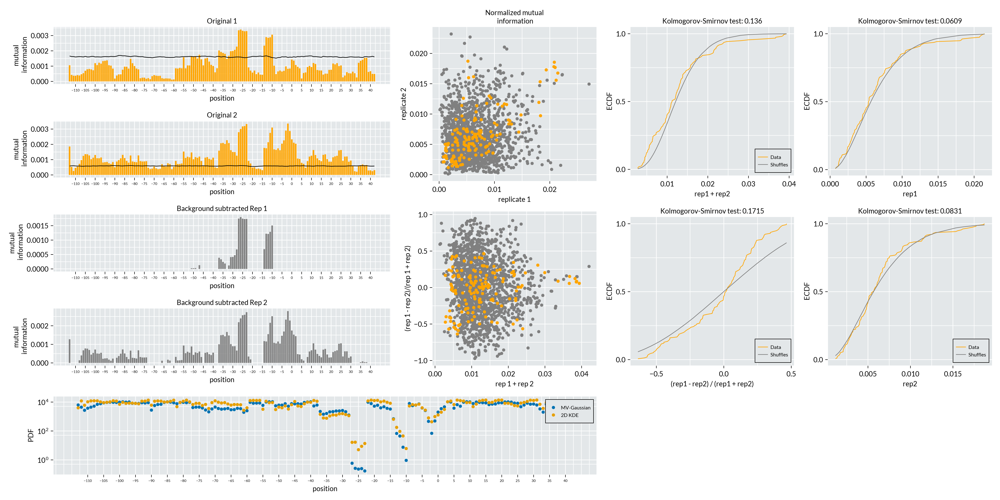

In [115]:
fig = shuffle_reps("3", "xylFp"; d=2, shuffles=1000)
save("xylF_xylose.pdf", fig)
fig

0.0013524077804162556
0.0005884206477703169


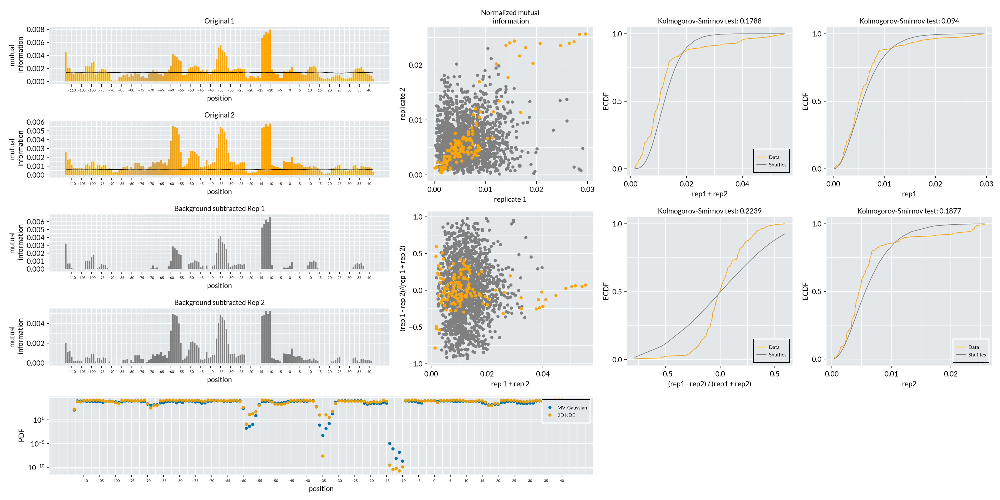

In [116]:
fig = shuffle_reps("2", "xylFp"; d=2, shuffles=1000)
save("xylF_xylose.pdf", fig)
fig

7.555610538215891e-5
7.502469278667164e-5


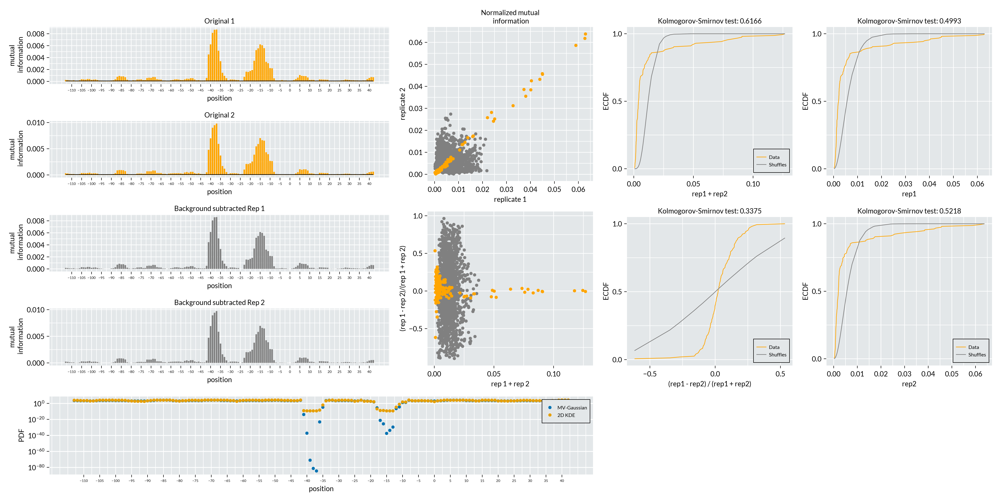

In [117]:
fig = shuffle_reps("29", "ftsKp1"; d=2, shuffles=1000)
save("ftsKp1_gent.pdf", fig)
fig

6.864800901419007e-5
6.891368203793143e-5


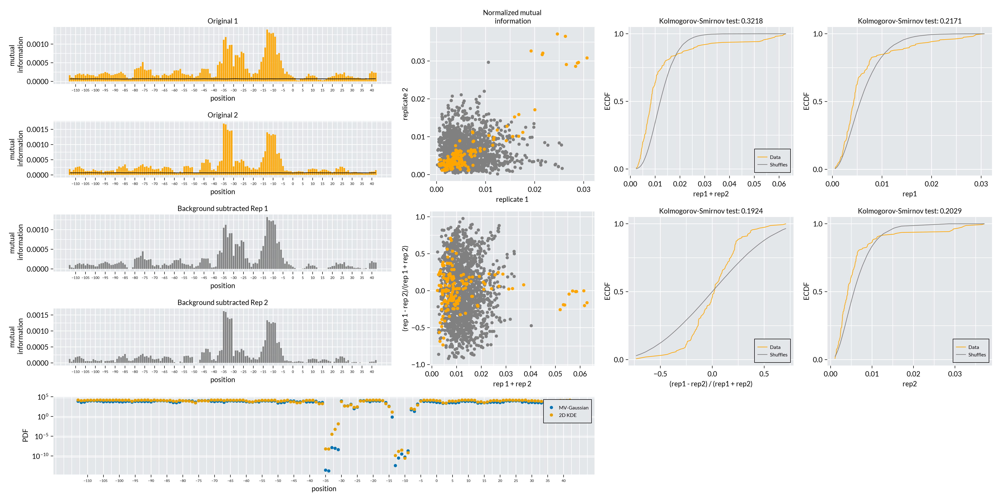

In [118]:
fig = shuffle_reps("29", "ftsKp2"; d=2, shuffles=1000)
save("ftsKp2_gent.pdf", fig)
fig

9.112439318528276e-5
9.18206219610623e-5


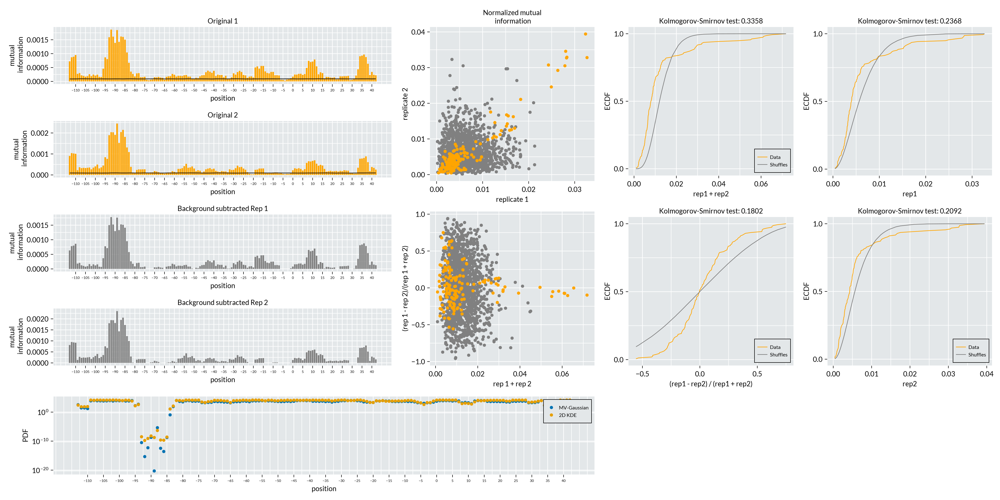

In [119]:
fig = shuffle_reps("29", "dgoRp"; d=2, shuffles=1000)
save("dgoR_gent.pdf", fig)
fig